## Arduino <> Python <> Plots 







#### In the unlikely event of having a normal functioning human being having an urge of plotting a beautiful graph with the data being entered from their Arduino device in real time, kindly follow the below mentioned steps. 

The codes used here has been heavily influenced from the work done by Alejandro Garcia and online sources which once tracked will be given due credit. 

Installling libraries for the normal functioning of our program. In absence of any of the below library please uncomment and run the code or write the most updated version following the syntax.

In [3]:
#!pip3 install pyserial    // for serial
#!pip3 install numpy
#!pip3 install scipy
#!pip3 install matplotlib
#!pip3 install pyqtgraph 

Note: The above code install libraries for Python version >= 3.0. If by god's grace you find yourself using Python 2.0, please use "!pip" instead of "!pip3". 

!pip install pyserial // for Python version 2.x
!pip3 install pyserial // for Python version 3.x

Run the below code for importing the libraries

In [4]:
import serial
import numpy as np
import scipy.fftpack
import datetime as dt
import time
import matplotlib.pyplot as plt
from pyqtgraph.Qt import QtGui, QtCore
import pyqtgraph as pg

In the next block, we are establishing a connection with the Arduino serial port. 

In [ ]:

#Opening serial where sensor data is coming in from
arduinoData = serial.Serial('COM4',115200) #Object to read from serial port4
arduinoData.close()
arduinoData.open()


"COM4" can be replaced by the appropriate port being used by the microcontroller and 115200 is the baud rate being used in the code.

In [ ]:
#Start QtApp
app = QtGui.QApplication([])
#Configuring window, must be done before creating widget
#pg.setConfigOption('antialias',True) Don't think this works with many plots. do this when setting data or plotting
pg.setConfigOption('background','k')
pg.setConfigOption('foreground','w')

In the above code we are configuring the how the window will look like when the plots come to the screen. This will be followed by window creation.

In [ ]:
#Creating Window
win = pg.GraphicsWindow(title="Signal from serial port")
win.resize(1000,600)

Now that the windows are configured, we need to 
- create the plots
- decide the position
- the look and name of the curves

win.addplot () adds a plot. Row and coloumn value needs to be specified and logically, two plots can't be in the same row and column location. 

In [ ]:

p2 = win.addPlot(row=1 , col=1 ,title="Accelerometer X") 
p4 = win.addPlot(row=2, col=1, title="Accelerometer Y" )

curve2 = p2.plot(pen='b',name='Acceleration X')
curve4 = p4.plot(pen='y', name='Acceleration Y')



After the crucial above step, we need to beautify our plots and make sure they are legible. In the below code, we will be setting the axis range, adding names, units and other important stuff revered by the technical community.

In [ ]:
WindowWidth = 200

#Formatting Plot 1
p2.showGrid(x=True,y=True)
p2.setLabel('left','Acceleration X',units='TBD')
p2.setLabel('bottom','Time',units='s')
p2.setYRange(-4000,6000)

You just need to repeat the above code block for rest of the plots with the appropriate changes. Remember, the code block modifies the title, units and other plot parts.

In [ ]:
#Formatting Plot 2

p4.showGrid(x=True,y=True)
p4.setLabel('left','Acceleration Y',units='TBD')
p4.setLabel('bottom','Time',unit='s')
p4.setYRange(-4000,10000)

Plots are ready. But what will they show there? We need to start capturing the data coming from the serial port. Going ahead, we need to create variables for capturing the incoming stream of data quickly while keeping saving it. Below code does that for us.

Friends reading this code, if you are having a better insight into the functioning of the code, please feel free to suggest edits.

In [ ]:
Xax = np.linspace(0,0,WindowWidth) # For storing incoming Acc value for X axis
Xay = np.linspace(0,0,WindowWidth) # For storing incoming Acc value for Y axis

Sampling = np.linspace(0,0,WindowWidth)
ptr = -WindowWidth

In [ ]:
xax = []
xay = []

yax = []
yay = []

start_time = time.time()

The variables are ready to accept the values. We will now be defining a function to accept the incoming data stream in proper variables.

In [ ]:
def update():
    global curve2, ptr, Xu, Xax,Xay, Sampling

    #Both Accel data coming in
    
    Xu[:-1] = Xu[1:]
    Xax[:-1] = Xax[1:]
    Xay[:-1] = Xay[1:]
    Sampling[:-1] = Sampling[1:]
    
    #Extracting data from arduino
    arduinoString = arduinoData.readline()   # Take notice. Data comes as rows of string. 
    #To use it as numbers we need to do some operations.
    
    dataString = arduinoString.decode(encoding="utf-8")
    dataArray = dataString.split(".")  # we are using "." as a delimiter to differentiate between two different values
    
    distance = float(dataArray[0]) # ignore this for now. It's a historical artifact and needs to be removed from here but will require some work
    accelx = float(dataArray[1])
    accely = float(dataArray[2])
    print(distance,'    ',accelx, ' ', accely)
    
    
    

    end_time = time.time()
    xax.append(end_time-start_time)
    yax.append(accelx)
    
    
    end_time = time.time()
    xay.append(end_time-start_time)
    yay.append(accely)
    
    #Plotting curves from the newly captured data
    Sampling[-1] = ptr
    Xu[-1] = distance # again, ignore for now
    Xax[-1] = accelx
    Xay[-1] = accely
    ptr += 1
    
    curve2.setData(Xax,antialias=True)
    curve4.setData(Xay,antialias=True)
    
    curve2.setPos(ptr,0)
    curve4.setPos(ptr,0)
    
    QtGui.QApplication.processEvents()

The hard work is done. Time to make it working. 

The below code will run the live data until we press Ctrl+C.

In [ ]:
#Runs Live data until keyboard interupt is pressed Ctrl+C
try:
    while True: update()
except KeyboardInterrupt:
    pass

In [ ]:
#Showing the Data/Figure last seen
plt.clf()

Giving the final touch to the plots. Use the below used code block multiple times with appropriate modifications to set the plots paramemters and legends.

In [ ]:
ax2 = fig.add_subplot(221)
plt.title('Final Time-Series (AccelerometerX)')
plt.xlabel('Time (s)')
plt.ylabel('Acceleration (TBD)')
ax2.set_ylim([-6000,6000])
ax2.plot(xax,yax,'b')

In [ ]:
ax3 = fig.add_subplot(221)
plt.title('Final Time-Series (AccelerometerY)')
plt.xlabel('Time (s)')
plt.ylabel('Acceleration (TBD)')
ax2.set_ylim([-6000,6000])
ax2.plot(xay,yay,'y')

To show the plot run the code below

In [ ]:
plt.show()


In [ ]:
pg.QtGui.QApplication.exec_()


## The above code will receive data from your Arduino serial port and plot the graph in real time. 


#### Remember to NOT open the serial monitor in Arduino while this program is running as the serial port can be accessed by only one program at a time.

We are attaching the associated code for Arduino too with this which will only run in the Arduino IDE. The code was implemented on an Arduino UNO and MPU 6050 IMU for reference. 

By changing the variables and making apt adjustments, this can be used for any sensor.

## Arduino Code 

### Arduino Uno + MPU 6050

Link to Arduino IDE <https://www.arduino.cc/en/Main/software>

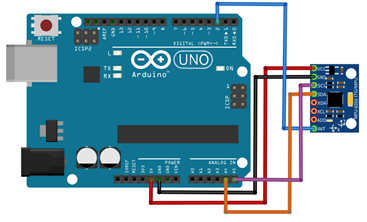

// MPU-6050 Short Example Sketch
//www.elegoo.com
//2016.12.9




#include<Wire.h>
const int MPU_addr=0x68;  // I2C address of the MPU-6050
int16_t AcX,AcY,AcZ,Tmp,GyX,GyY,GyZ;

int i=0;
void setup(){
  Wire.begin();
  Wire.beginTransmission(MPU_addr);
  Wire.write(0x6B);  // PWR_MGMT_1 register
  Wire.write(0);     // set to zero (wakes up the MPU-6050)
  Wire.endTransmission(true);

  Serial.begin(115200);
}


void loop(){
  Wire.beginTransmission(MPU_addr);
  Wire.write(0x3B);  // starting with register 0x3B (ACCEL_XOUT_H)
  Wire.endTransmission(false);
  Wire.requestFrom(MPU_addr,14,true);  // request a total of 14 registers
  AcX=Wire.read()<<8|Wire.read();  // 0x3B (ACCEL_XOUT_H) & 0x3C (ACCEL_XOUT_L)    
  AcY=Wire.read()<<8|Wire.read();  // 0x3D (ACCEL_YOUT_H) & 0x3E (ACCEL_YOUT_L)
  AcZ=Wire.read()<<8|Wire.read();  // 0x3F (ACCEL_ZOUT_H) & 0x40 (ACCEL_ZOUT_L)
  Tmp=Wire.read()<<8|Wire.read();  // 0x41 (TEMP_OUT_H) & 0x42 (TEMP_OUT_L)
  GyX=Wire.read()<<8|Wire.read();  // 0x43 (GYRO_XOUT_H) & 0x44 (GYRO_XOUT_L)
  GyY=Wire.read()<<8|Wire.read();  // 0x45 (GYRO_YOUT_H) & 0x46 (GYRO_YOUT_L)
  GyZ=Wire.read()<<8|Wire.read();  // 0x47 (GYRO_ZOUT_H) & 0x48 (GYRO_ZOUT_L)

  Serial.print(i++);
  Serial.print(".");  
  Serial.print(AcX);
  Serial.print(".");  

  Serial.println(AcY);
  // Serial.print(" | AcZ = "); Serial.println(AcZ);
  
  //Serial.print(" | Tmp = "); Serial.println(Tmp/340.00+36.53);  //equation for temperature in degrees C from datasheet
  //Serial.print(" | GyX = "); Serial.println(GyX);
  //Serial.print(" | GyY = "); Serial.println(GyY);
  //Serial.print(" | GyZ = "); Serial.println(GyZ);
  //Serial.println();
  delay(10);
}

## Worked out examples for 2 graphs

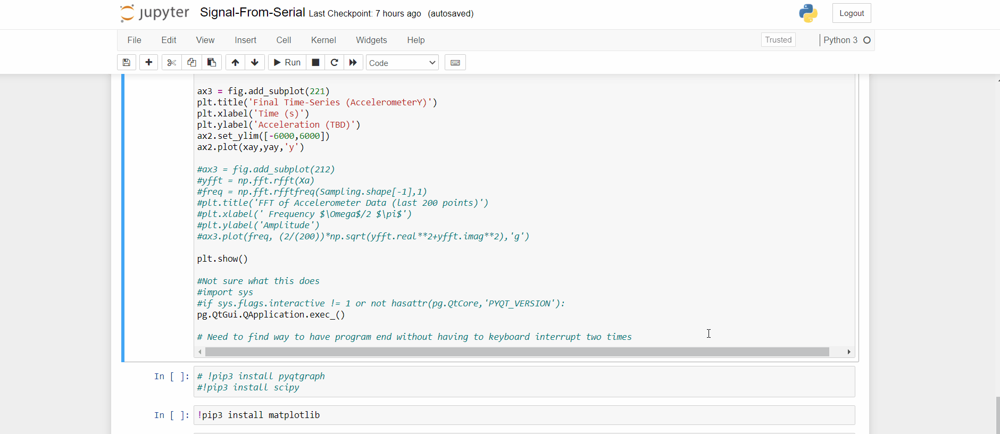

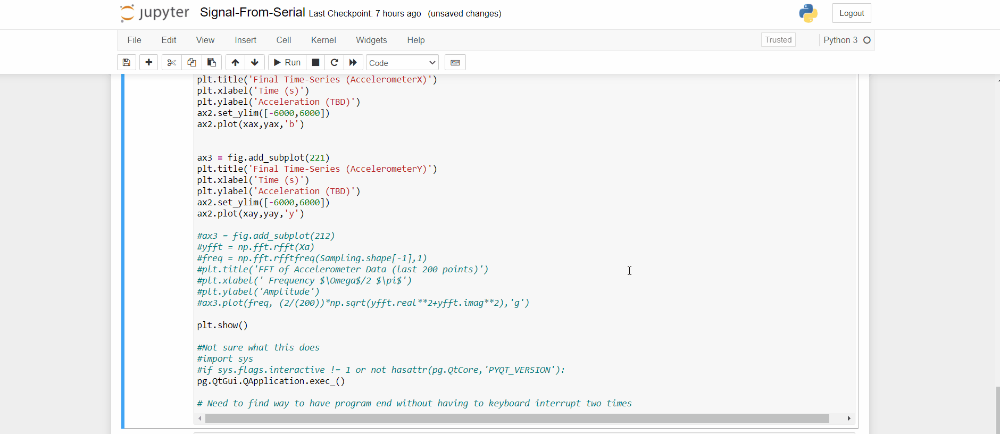